In [1]:

# import basic libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm


from networkx.algorithms import community
from matplotlib.colors import ListedColormap
from sklearn.cluster import SpectralClustering
import plotly.graph_objects as go
import jinja2
import networkx as nx
import community as community_louvain
from networkx.algorithms.community import greedy_modularity_communities



ModuleNotFoundError: No module named 'plotly'

In [18]:
# Load node and edge files
node_file = 'redo_again/node_list_youtube.csv'
edge_file = 'redo_again/edge_list_youtube2.csv'

nodes = pd.read_csv(node_file)
edges = pd.read_csv(edge_file)

# Create a graph
G = nx.Graph()

# Add nodes with labels
for _, row in nodes.iterrows():
    G.add_node(row['id'], label=row['label'])

# Add edges with labels
for _, row in edges.iterrows():
    G.add_edge(
        row['Source'], 
        row['Target'], 
        weight=row['Weight'], 
        label=row['Label']  # Add the edge label
    )


In [3]:
# print the nodes and edges of the graph
print(G.nodes())
print(G.edges())

['UCkJEpR7JmS36tajD34Gp4VA', 'UC7qWEIEPqtsXlHY7gcqIpvQ', 'UC_UwerUx8bGApFn_oIAuilw', 'UCoQvGj7Pn_nojGAQvF_dIUg', 'UCZl8zqriMKlJJEFm2P1nkAQ', 'UCFeFjSKyq2fwn8KODb0LTtw', 'UCogWI9kVVvmRRPzzQBrOwzg', 'UCEMMrXP3_WeKiOunPYixMfA', 'UC7yA3gzd_YZgb-MIuKM_rLQ', 'UCKECwHOIAZkpv7c1hqg1mWw', 'UCVlQXBPDCbz5YES_gBpC1rg', 'UCwHhakZGzBCjGYfPtbROAVw', 'UCzTlGbETak1uwQnbkYKZe_w', 'UC0kcFbtKTaC3JYnvPR5LI8w', 'UC50vyjmknAf3nMvOr37gm1Q', 'UC_eifcIIjgN8Q_8m34nWo3Q', 'UCkz70nAcMWjluBljiZaC_fA', 'UCJ6JnLmidOIP1sFeK8hRspA', 'UCoIrYeJZSMIX78UCkaVvpZw', 'UC5BMIWZe9isJXLZZWPWvBlg', 'UCPAxpUn1mrn14xU0JpsLhDg', 'UCtMUw9qZ_9VuS2eL_Rvzo3w', 'UCcD1h3xL6xa9ofkLUiJFHuA', 'UCgKxmZNgM7fi-E6Yidr-Q6g', 'UCSkOqbajcG6-jguycOHzhDg', 'UCRPWx7xrHni4v31AkXE16Fg', 'UCoF5kaKbVs0aGi0HM8kPvhg', 'UChHqwEJMBFK0X5nENZYfh-g', 'UCurzG_fehw0GqQ5es0YbFpg', 'UCxiFTELKoiMWNd2-2FUUSzw', 'UCamwEBao0i0J1_Nqf3beqgA', 'UCX-4mrOc5r691SzDhHtkOgw', 'UC35G_cCk1aTGTm_poW_pO9g', 'UCmxAIW7RDDC88EPk4ry16Kg', 'UCu0yQD7NFMyLu_-TmKa4Hqg', 'UCfwrigYqhf-45FK_7

Saved: degree_centrality_centrality.png


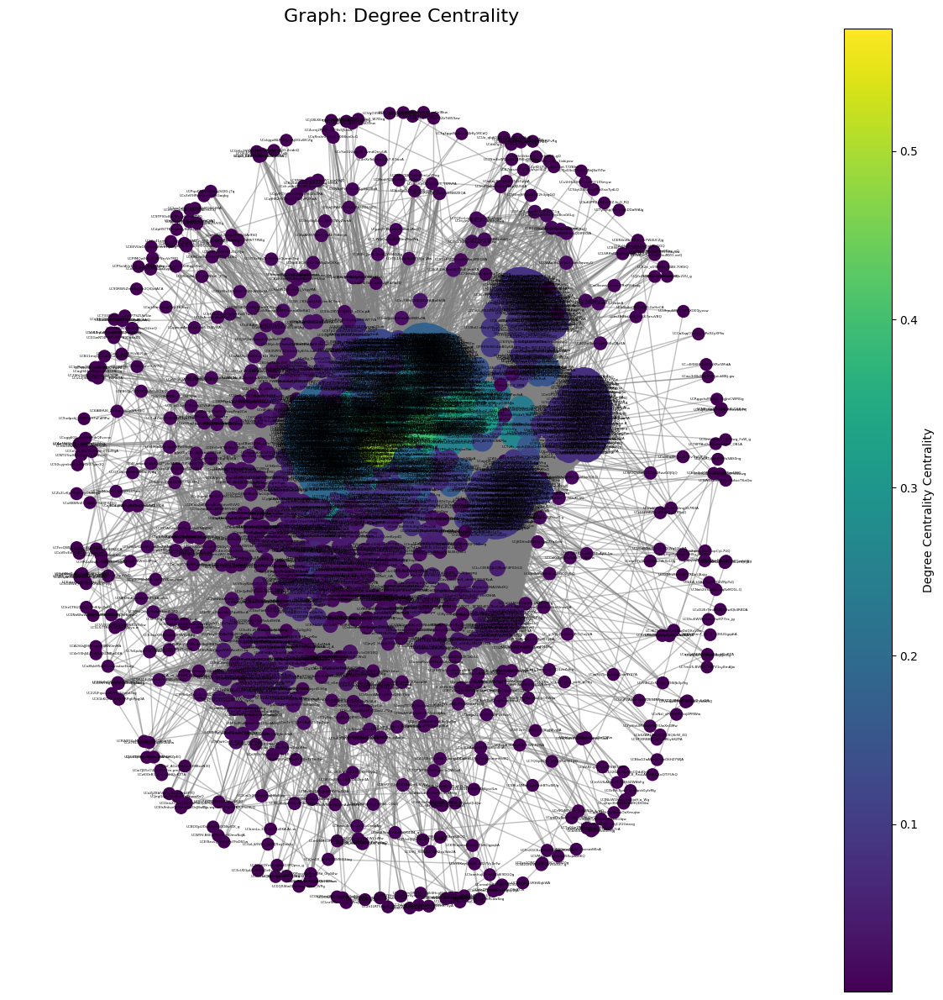

Saved: closeness_centrality_centrality.png


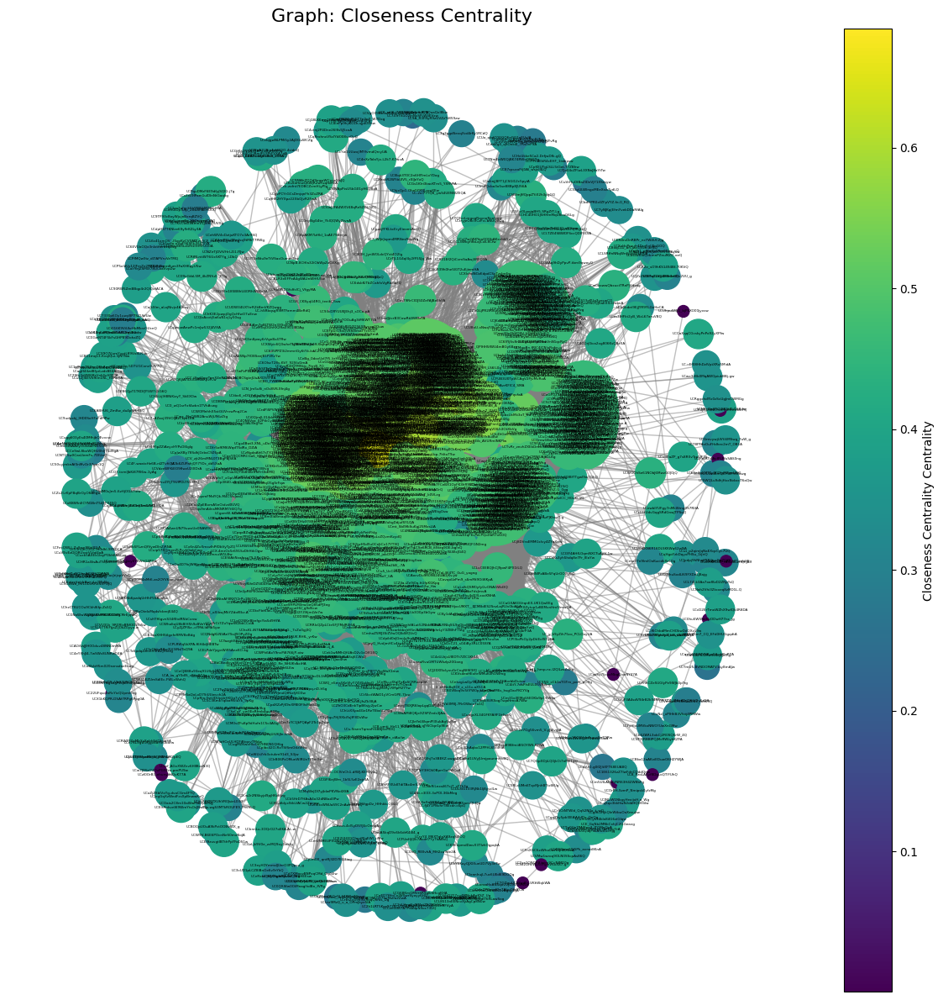

Saved: betweenness_centrality_centrality.png


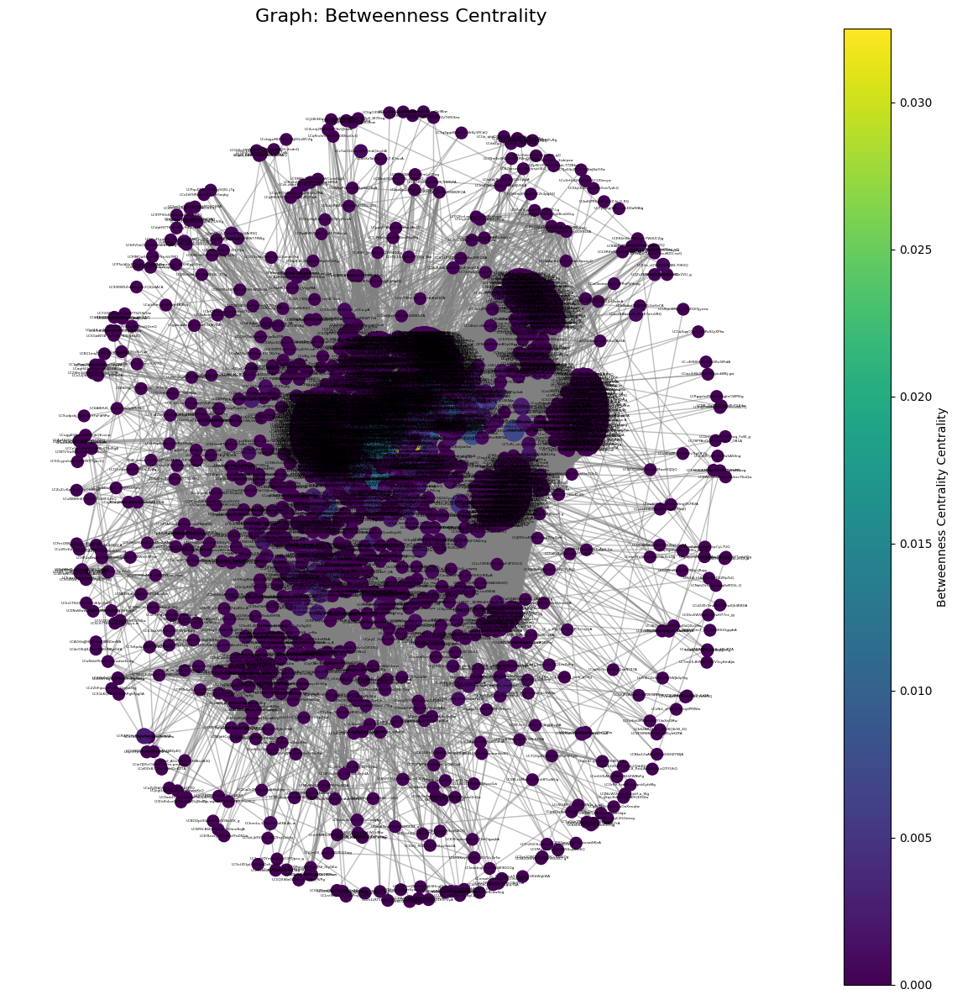

Saved: pagerank_centrality.png


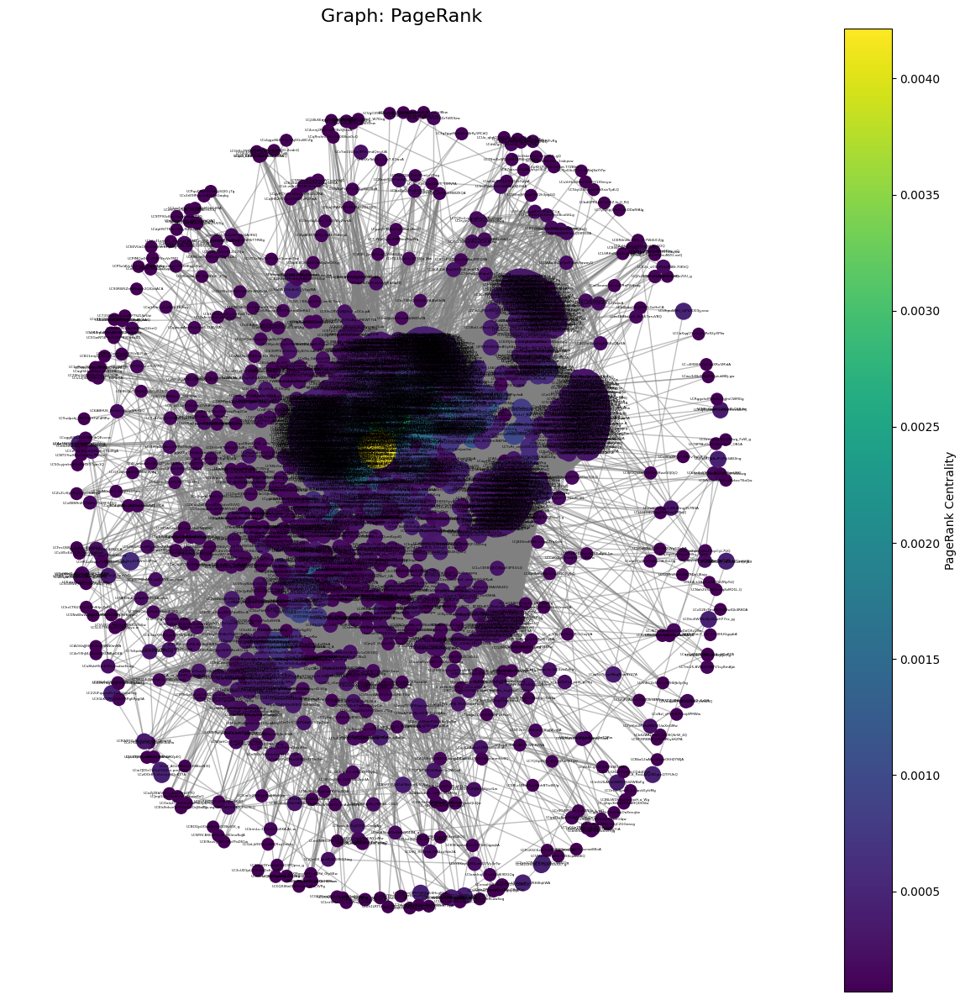

In [10]:
import matplotlib.pyplot as plt
import networkx as nx

# Convert centralities to dictionaries for easy access
centralities = {
    "Degree Centrality": nx.degree_centrality(G),
    "Closeness Centrality": nx.closeness_centrality(G),
    "Betweenness Centrality": nx.betweenness_centrality(G),
    "PageRank": nx.pagerank(G),
}

# Layout for the graph with adjusted spacing to avoid overlaps
pos = nx.spring_layout(G, k=2, iterations=300)

# Function to scale values between a given range (min_size to max_size)
def scale_values(values, min_size, max_size):
    min_val = min(values)
    max_val = max(values)
    scaled = [(max_size - min_size) * (value - min_val) / (max_val - min_val) + min_size for value in values]
    return scaled

# Define a function to create static plots for each centrality
def plot_centrality_graph_matplotlib(G, centrality, title):
    # Scale node sizes based on centrality values
    centrality_values = list(centrality.values())
    node_sizes = scale_values(centrality_values, 100, 1000)  # Scale node sizes

    # Create the graph plot
    plt.figure(figsize=(12, 12))
    nx.draw_networkx_edges(G, pos, alpha=0.5, edge_color="gray")
    nodes = nx.draw_networkx_nodes(
        G, pos, node_size=node_sizes, node_color=centrality_values, cmap=plt.cm.viridis
    )
    nx.draw_networkx_labels(G, pos, font_size=3, font_color="black")

    # Add a color bar
    plt.colorbar(nodes, label=f"{title} Centrality")

    # Set plot title and adjust layout
    plt.title(f"Graph: {title}", fontsize=16)
    plt.axis("off")
    plt.tight_layout()

    # Save the plot as an image
    plt.savefig(f"{title.replace(' ', '_').lower()}_centrality.png", dpi=300)
    print(f"Saved: {title.replace(' ', '_').lower()}_centrality.png")

    # Show the plot
    plt.show()

# Plot and save each centrality graph
for centrality_name, centrality_values in centralities.items():
    plot_centrality_graph_matplotlib(G, centrality_values, centrality_name)


In [ ]:
# import plotly.graph_objects as go

# # Convert centralities to dictionaries for easy access
# centralities = {
#     "Degree Centrality": nx.degree_centrality(G),
#     "Closeness Centrality": nx.closeness_centrality(G),
#     "Betweenness Centrality": nx.betweenness_centrality(G),
#     "PageRank": nx.pagerank(G),
# }

# # Layout for the graph with adjusted spacing to avoid overlaps
# pos = nx.spring_layout(G, k=2, iterations=300)

# # Function to scale values between a given range (min_size to max_size)
# def scale_values(values, min_size, max_size):
#     min_val = min(values)
#     max_val = max(values)
#     scaled = [(max_size - min_size) * (value - min_val) / (max_val - min_val) + min_size for value in values]
#     return scaled

# # Define a function to create interactive plots for each centrality
# def plot_centrality_graph_with_labels(G, centrality, title):
#     # Extract edge coordinates and labels for Plotly
#     edge_x = []
#     edge_y = []
#     edge_labels_x = []
#     edge_labels_y = []
#     edge_labels_text = []

#     for edge in G.edges(data=True):
#         x0, y0 = pos[edge[0]]
#         x1, y1 = pos[edge[1]]
#         edge_x.extend([x0, x1, None])
#         edge_y.extend([y0, y1, None])
        
#         # Calculate midpoint for edge label
#         edge_labels_x.append((x0 + x1) / 2)
#         edge_labels_y.append((y0 + y1) / 2)
#         edge_labels_text.append(edge[2].get('label', ''))  # Extract edge label

#     # Extract node coordinates and centrality values
#     node_x = []
#     node_y = []
#     node_labels = []
#     centrality_values = []
#     for node in G.nodes():
#         x, y = pos[node]
#         node_x.append(x)
#         node_y.append(y)
#         node_labels.append(G.nodes[node].get('label', str(node)))
#         centrality_values.append(centrality[node])

#     # Scale node sizes and label font sizes
#     node_sizes = scale_values(centrality_values, 5, 25)  # Scale node sizes (5 to 25)
#     font_sizes = scale_values(centrality_values, 3, 5)  # Scale font sizes (3 to 5)

#     # Create edge trace
#     edge_trace = go.Scatter(
#         x=edge_x,
#         y=edge_y,
#         line=dict(width=1, color='gray'),
#         hoverinfo='none',
#         mode='lines'
#     )

#     # Create edge label trace
#     edge_label_trace = go.Scatter(
#         x=edge_labels_x,
#         y=edge_labels_y,
#         text=edge_labels_text,
#         mode='text',
#         textfont=dict(size=2, color='black'),
#         hoverinfo='text'
#     )

#     # Create node trace
#     node_trace = go.Scatter(
#         x=node_x,
#         y=node_y,
#         mode='markers+text',
#         text=node_labels,
#         textfont=dict(size=font_sizes, color='black'),
#         marker=dict(
#             size=node_sizes,  # Use scaled node sizes
#             color=centrality_values,
#             colorscale='Viridis',
#             colorbar=dict(
#                 title=f"{title} Centrality",
#                 thickness=15
#             ),
#             showscale=True
#         ),
#         hoverinfo="text"
#     )

#     # Create figure
#     fig = go.Figure(data=[edge_trace, edge_label_trace, node_trace],
#                     layout=go.Layout(
#                         title=f"Interactive Graph: {title}",
#                         titlefont_size=16,
#                         showlegend=False,
#                         hovermode='closest',
#                         margin=dict(b=0, l=0, r=0, t=30),
#                         xaxis=dict(showgrid=False, zeroline=False),
#                         yaxis=dict(showgrid=False, zeroline=False)
#                     ))
    
#     # Save the figure as an HTML file
#     html_file = f"{title.replace(' ', '_').lower()}_centrality_edge_label.html"
#     fig.write_html(html_file)
#     print(f"Saved: {html_file}")

#     # Show the figure
#     fig.show()

# # Plot and save each centrality graph
# for centrality_name, centrality_values in centralities.items():
#     plot_centrality_graph_with_labels(G, centrality_values, centrality_name)


In [20]:
# Recompute centrality measures
degree_centrality = nx.degree_centrality(G)
closeness_centrality = nx.closeness_centrality(G)
betweenness_centrality = nx.betweenness_centrality(G)
pagerank = nx.pagerank(G,alpha=0.85, tol=0.001)

# Retrieve node labels from the graph
node_labels = nx.get_node_attributes(G, 'label')

# Define a function to print the top nodes with their labels for each centrality measure
def print_top_nodes_with_labels(centrality_measure, centrality_dict, top_n):
    print(centrality_measure + ":\n")
    for node, value in sorted(centrality_dict.items(), key=lambda x: x[1], reverse=True)[:top_n]:
        label = node_labels.get(node, "No Label")  # Use label or fallback to "No Label"
        print(f"Node Label: {label}, Centrality Value: {value:.3f}")
    print("\n")

# Print the top 5 nodes with labels for each centrality measure
print_top_nodes_with_labels("Degree Centrality", degree_centrality, 5)
print_top_nodes_with_labels("Closeness Centrality", closeness_centrality, 5)
print_top_nodes_with_labels("Betweenness Centrality", betweenness_centrality, 5)
print_top_nodes_with_labels("Page Rank", pagerank, 5)

Degree Centrality:

Node Label: TopengPening, Centrality Value: 0.350
Node Label: I Big Wonder Intelligent School, Centrality Value: 0.340
Node Label: Free Malaysia Today, Centrality Value: 0.336
Node Label: HEALEADTEACH, Centrality Value: 0.323
Node Label: Alexis Larue, Centrality Value: 0.317


Closeness Centrality:

Node Label: TopengPening, Centrality Value: 0.418
Node Label: I Big Wonder Intelligent School, Centrality Value: 0.412
Node Label: Free Malaysia Today, Centrality Value: 0.406
Node Label: Alexis Larue, Centrality Value: 0.405
Node Label: MacDonald..., Centrality Value: 0.404


Betweenness Centrality:

Node Label: TopengPening, Centrality Value: 0.012
Node Label: Alexis Larue, Centrality Value: 0.007
Node Label: MacDonald..., Centrality Value: 0.006
Node Label: Free Malaysia Today, Centrality Value: 0.006
Node Label: I Big Wonder Intelligent School, Centrality Value: 0.005


Page Rank:

Node Label: Alexis Larue, Centrality Value: 0.003
Node Label: MacDonald..., Centrality

In [13]:
# Check Reciprocity
if nx.is_directed(G):
    reciprocity = nx.reciprocity(G)
    print(f"Reciprocity: {reciprocity:.3f}")
else:
    print("Reciprocity: Not applicable for undirected graphs")

# Compute Transitivity
transitivity = nx.transitivity(G)
print(f"Transitivity: {transitivity:.3f}")

# Compute Jaccard Similarity
jaccard = nx.jaccard_coefficient(G)

# Sort the pairs by similarity score in descending order
sorted_jaccard = sorted(jaccard, key=lambda x: x[2], reverse=True)

# Retrieve node labels from the graph
node_labels = nx.get_node_attributes(G, 'label')

# Print top 5 pairs by Jaccard Similarity with node labels
print("\nTop 5 Pairs by Jaccard Similarity (with Node Labels):")
for u, v, p in sorted_jaccard[:5]:  # Top 5 pairs
    label_u = node_labels.get(u, str(u))  # Get label or fallback to ID
    label_v = node_labels.get(v, str(v))  # Get label or fallback to ID
    print(f"Nodes ({label_u}, {label_v}): Similarity = {p:.3f}")




Reciprocity: Not applicable for undirected graphs
Transitivity: 0.672

Top 5 Pairs by Jaccard Similarity (with Node Labels):
Nodes (Ash Shiddiq, Murajaah Channel): Similarity = 1.000
Nodes (YURA YUNITA, Ikram Rauhi): Similarity = 1.000
Nodes (YURA YUNITA, Sinto): Similarity = 1.000
Nodes (Ikram Rauhi, Sinto): Similarity = 1.000
Nodes (Story Dakwah, CERAMAH KEHIDUPAN): Similarity = 1.000


In [ ]:
import time
import matplotlib.pyplot as plt
import networkx as nx
from community import community_louvain

# Compute the best partition using the Louvain method and measure the time of computation
start_time = time.time()
partition = community_louvain.best_partition(G)
end_time = time.time()
computation_time = end_time - start_time

# Compute the modularity of the partition
modularity = community_louvain.modularity(partition, G)

# Compute the number of communities
num_communities = len(set(partition.values()))

# Print the metrics
print("Louvain Method Results:")
print(f"Modularity: {modularity:.4f}")
print(f"Number of Communities: {num_communities}")
print(f"Time of Computation: {computation_time:.4f} seconds")

# Improved Visualization for the Louvain Method
plt.figure(figsize=(12, 12))

# Recompute layout with increased spacing
pos = nx.spring_layout(G, k=1.5, iterations=250)

# Fixed node size
fixed_node_size = 300

# Draw nodes with community colors and fixed sizes
nx.draw_networkx_nodes(
    G, pos, node_color=[partition[node] for node in G.nodes()], cmap=plt.cm.jet, node_size=fixed_node_size, alpha=0.9
)

# Draw edges with reduced prominence
nx.draw_networkx_edges(G, pos, alpha=0.3, edge_color='gray')

# Add node labels
nx.draw_networkx_labels(G, pos, labels=nx.get_node_attributes(G, 'label'), font_size=3, font_color='black')

# Add a title
plt.title("Improved Louvain Method Community Detection")
plt.axis('off')
plt.show()


In [ ]:
import time
import networkx as nx
import plotly.graph_objects as go
from community import community_louvain

# Function to scale values to a specified range
def scale_values(values, min_size, max_size):
    min_val = min(values)
    max_val = max(values)
    scaled = [(max_size - min_size) * (value - min_val) / (max_val - min_val) + min_size for value in values]
    return scaled

# Compute the best partition using the Louvain method and measure the time of computation
start_time = time.time()
partition = community_louvain.best_partition(G)
end_time = time.time()
computation_time = end_time - start_time

# Compute the modularity of the partition
modularity = community_louvain.modularity(partition, G)

# Compute the number of communities
num_communities = len(set(partition.values()))

# Print the metrics
print("Louvain Method Results:")
print(f"Modularity: {modularity:.4f}")
print(f"Number of Communities: {num_communities}")
print(f"Time of Computation: {computation_time:.4f} seconds")

# Define custom colors for communities
custom_colors = [
    "orange", "red", "yellow", "blue", "green", "purple", "cyan", "pink", "brown", "teal"
]

# Assign colors to each community
community_colors = {community: custom_colors[i % len(custom_colors)] for i, community in enumerate(set(partition.values()))}

# Compute betweenness centrality for node size scaling
betweenness_centrality = nx.betweenness_centrality(G)
node_size_values = [betweenness_centrality[node] for node in G.nodes()]
node_sizes = scale_values(node_size_values, 10, 50)  # Scale node sizes (1 to 20)

# Layout for the graph with adjusted spacing to avoid overlaps
pos = nx.spring_layout(G, k=1.5, iterations=250)

# Prepare node data for Plotly
node_labels = []
node_x = []
node_y = []
node_colors = []
for node in G.nodes():
    x, y = pos[node]
    node_x.append(x)
    node_y.append(y)
    node_labels.append(G.nodes[node].get('label', str(node)))
    node_colors.append(community_colors[partition[node]])  # Use custom colors for communities

# Extract edge coordinates
edge_x = []
edge_y = []
for edge in G.edges():
    x0, y0 = pos[edge[0]]
    x1, y1 = pos[edge[1]]
    edge_x.extend([x0, x1, None])
    edge_y.extend([y0, y1, None])

# Create edge trace
edge_trace = go.Scatter(
    x=edge_x,
    y=edge_y,
    line=dict(width=1, color='gray'),
    hoverinfo='none',
    mode='lines'
)

# Create node trace with custom colors
node_trace = go.Scatter(
    x=node_x,
    y=node_y,
    mode='markers+text',
    text=node_labels,
    textfont=dict(size=5, color='black'),  # Label font size is fixed
    marker=dict(
        size=node_sizes,  # Scaled node sizes based on betweenness centrality
        color=node_colors,  # Use custom colors
        showscale=False  # Disable the colorbar since we're using fixed colors
    ),
    hoverinfo="text"
)

# Create the Plotly figure
fig = go.Figure(data=[edge_trace, node_trace],
                layout=go.Layout(
                    title="Interactive Louvain Method Community Detection (Custom Colors)",
                    titlefont_size=16,
                    showlegend=False,
                    hovermode='closest',
                    margin=dict(b=0, l=0, r=0, t=30),
                    xaxis=dict(showgrid=False, zeroline=False),
                    yaxis=dict(showgrid=False, zeroline=False)
                ))

# Save the figure as an HTML file
fig.write_html("louvain_community_detection.html")

# Show the figure
fig.show()


In [ ]:
# Assign each node to its community color
node_labels = nx.get_node_attributes(G, 'label')  # Retrieve node labels
communities_with_colors = {node: (partition[node], node_labels.get(node, f"Node {node}")) for node in G.nodes()}

# Group nodes by their community (color)
community_groups = {}
for node, (community, label) in communities_with_colors.items():
    if community not in community_groups:
        community_groups[community] = []
    community_groups[community].append((node, label))

# Display nodes grouped by community
for community, nodes in community_groups.items():
    print(f"Community {community}:")
    for node, label in nodes:
        print(f"  Node ID: {node}, Label: {label}")
    print("\n")

In [ ]:
from matplotlib.colors import ListedColormap
from networkx.algorithms.community import girvan_newman

comp = girvan_newman(G)
best_division = tuple(sorted(c) for c in next(comp))  # First-level communities
num_communities = len(best_division)
colors = plt.cm.get_cmap('tab20', num_communities).colors  # Generate dynamic colormap
dynamic_cmap = ListedColormap(colors[:num_communities])

# Create a dictionary mapping each node to its community index
community_dict = {node: i for i, community in enumerate(best_division) for node in community}

# Improved Visualization for the Girvan-Newman Method (Fixed Node Size)
plt.figure(figsize=(12, 12))

# Recompute layout with increased spacing
pos = nx.spring_layout(G, k=0.3, iterations=50)

# Fixed node size
fixed_node_size = 300

# Draw nodes with community colors and fixed sizes
nx.draw_networkx_nodes(
    G, pos, community_dict.keys(),
    node_size=fixed_node_size, cmap=dynamic_cmap, node_color=list(community_dict.values()), alpha=0.9
)

# Draw edges with reduced prominence
nx.draw_networkx_edges(G, pos, alpha=0.3, edge_color='gray')

# Draw labels with better positioning
nx.draw_networkx_labels(G, pos, labels=nx.get_node_attributes(G, 'label'), font_size=3, font_color='black')

# Add a title
plt.title("Improved Community Detection using the Girvan-Newman Method")
plt.axis('off')
plt.show()

In [ ]:
import plotly.graph_objects as go
from networkx.algorithms.community import girvan_newman

# Compute the Girvan-Newman communities (first level of communities)
comp = girvan_newman(G)
best_division = tuple(sorted(c) for c in next(comp))  # First-level communities
num_communities = len(best_division)

# Define a custom colorscale with specific colors
custom_colors = [ "red", "yellow", "blue", "green", "orange","purple", "cyan", "pink"]
custom_colorscale = [[i / (len(custom_colors) - 1), color] for i, color in enumerate(custom_colors)]

# Create a dictionary mapping each node to its community index
community_dict = {node: i for i, community in enumerate(best_division) for node in community}

# Layout for the graph with adjusted spacing to avoid overlaps
pos = nx.spring_layout(G, k=1.5, iterations=250)

# Prepare node data for Plotly
node_x = []
node_y = []
node_labels = []
node_colors = []
for node in G.nodes():
    x, y = pos[node]
    node_x.append(x)
    node_y.append(y)
    node_labels.append(G.nodes[node].get('label', str(node)))
    node_colors.append(community_dict[node])  # Use community index for coloring

# Extract edge coordinates
edge_x = []
edge_y = []
for edge in G.edges():
    x0, y0 = pos[edge[0]]
    x1, y1 = pos[edge[1]]
    edge_x.extend([x0, x1, None])
    edge_y.extend([y0, y1, None])

# Create edge trace
edge_trace = go.Scatter(
    x=edge_x,
    y=edge_y,
    line=dict(width=1, color='gray'),
    hoverinfo='none',
    mode='lines'
)

# Create node trace with custom colors
node_trace = go.Scatter(
    x=node_x,
    y=node_y,
    mode='markers+text',
    text=node_labels,
    textfont=dict(size=5, color='black'),
    marker=dict(
        size=10,  # Fixed node sizes
        color=node_colors,  # Community-based coloring
        colorscale=custom_colorscale,  # Use the custom colorscale
        showscale=True,
        colorbar=dict(
            title="Community",
            thickness=15
        )
    ),
    hoverinfo="text"
)

# Create the Plotly figure
fig = go.Figure(data=[edge_trace, node_trace],
                layout=go.Layout(
                    title="Interactive Girvan-Newman Community Detection (Custom Colors)",
                    titlefont_size=16,
                    showlegend=False,
                    hovermode='closest',
                    margin=dict(b=0, l=0, r=0, t=30),
                    xaxis=dict(showgrid=False, zeroline=False),
                    yaxis=dict(showgrid=False, zeroline=False)
                ))

# Save the figure as an HTML file
fig.write_html("girvan_newman_custom_colors.html")

# Show the figure
fig.show()


In [ ]:
# Ensure all nodes have a label; fallback to node ID if no label exists
node_labels = nx.get_node_attributes(G, 'label')
default_labels = {node: node_labels.get(node, f"Node {node}") for node in G.nodes()}

# List communities with their node labels
communities_with_labels = [
    {node: default_labels[node] for node in community} for community in best_division
]

# Display the communities with node labels
for i, community in enumerate(communities_with_labels, start=1):
    print(f"Community {i}:")
    for node, label in community.items():
        print(f"  Node ID: {node}, Label: {label}")
    print("\n")

In [ ]:
import plotly.graph_objects as go
from sklearn.cluster import SpectralClustering

# Compute the adjacency matrix of the network
A = nx.adjacency_matrix(G).toarray()

# Create a spectral clustering model with 4 clusters
n_clusters = 4
sc = SpectralClustering(n_clusters, affinity='precomputed', n_init=100, random_state=42)

# Fit the model to the adjacency matrix
sc.fit(A)

# Get the labels of the nodes in each community
labels = sc.labels_

# Create a dictionary that maps each node to a community
community_dict = {node: labels[i] for i, node in enumerate(G.nodes())}

# Prepare node data for Plotly
pos = nx.spring_layout(G, k=0.3, iterations=50)  # Adjust layout for more spacing
node_x = []
node_y = []
node_labels = []
node_colors = []
for node in G.nodes():
    x, y = pos[node]
    node_x.append(x)
    node_y.append(y)
    node_labels.append(G.nodes[node].get('label', str(node)))
    node_colors.append(community_dict[node])  # Use community index for coloring

# Extract edge coordinates
edge_x = []
edge_y = []
for edge in G.edges():
    x0, y0 = pos[edge[0]]
    x1, y1 = pos[edge[1]]
    edge_x.extend([x0, x1, None])
    edge_y.extend([y0, y1, None])

# Convert custom colors to a valid Plotly colorscale
custom_colorscale = [
    [0, 'orange'],
    [0.25, 'red'],
    [0.5, 'yellow'],
    [0.75, 'blue'],
    [1.0, 'green']
]

# Create edge trace
edge_trace = go.Scatter(
    x=edge_x,
    y=edge_y,
    line=dict(width=1, color='gray'),
    hoverinfo='none',
    mode='lines'
)

# Create node trace with custom colorscale
node_trace = go.Scatter(
    x=node_x,
    y=node_y,
    mode='markers+text',
    text=node_labels,
    textfont=dict(size=5, color='black'),
    marker=dict(
        size=10,  # Fixed node sizes
        color=node_colors,  # Community-based coloring
        colorscale=custom_colorscale,  # Valid Plotly colorscale
        showscale=True,
        colorbar=dict(
            title="Community",
            thickness=15
        )
    ),
    hoverinfo="text"
)

# Create the Plotly figure
fig = go.Figure(data=[edge_trace, node_trace],
                layout=go.Layout(
                    title="Interactive Spectral Clustering Community Detection",
                    titlefont_size=16,
                    showlegend=False,
                    hovermode='closest',
                    margin=dict(b=0, l=0, r=0, t=30),
                    xaxis=dict(showgrid=False, zeroline=False),
                    yaxis=dict(showgrid=False, zeroline=False)
                ))

# Save the figure as an HTML file
fig.write_html("spectral_clustering_community_detection.html")

# Show the figure
fig.show()


In [ ]:
# Calculate the number of communities
num_communities = len(set(community_dict.values()))

# Print the number of communities
print(f"Number of Communities: {num_communities}")

# Print community details
print("\nSpectral Clustering Communities:")
communities = {}
for node, community in community_dict.items():
    if community not in communities:
        communities[community] = []
    communities[community].append(node)

# Print nodes in each community
for community, nodes in communities.items():
    print(f"\nCommunity {community + 1}:")
    for node in nodes:
        label = nx.get_node_attributes(G, 'label').get(node, f"Node {node}")
        print(f"  Node ID: {node}, Label: {label}")
